<a href="https://colab.research.google.com/github/vs0311/assistive-vision-jiit/blob/main/project_src.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install kaggle
!pip install gtts


import nltk
from keras.applications.resnet50 import ResNet50, preprocess_input
import tensorflow as tf
import numpy as np
import string
import keras
import json
from keras.layers import *
from keras.models import Model,load_model
from keras.preprocessing import image
import matplotlib.pyplot as plt
from keras.utils import to_categorical
from keras.layers import Input,Dense,Dropout,Embedding,LSTM
from keras.layers.merge import add
from keras.preprocessing.sequence import pad_sequences
from keras.applications.inception_v3 import InceptionV3
from keras import optimizers
from gtts import gTTS
import os
import sys
import cv2

from google.colab import files
files.upload()

!pip install -q kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!ls ~/.kaggle
!chmod 600 /root/.kaggle/kaggle.json

!kaggle datasets download -d adityajn105/flickr8k
!unzip flickr8k.zip


Saving kaggle.json to kaggle (1).json
kaggle.json
flickr8k.zip: Skipping, found more recently modified local copy (use --force to force download)
Archive:  flickr8k.zip
replace Images/1000268201_693b08cb0e.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:
import pickle

def readTextFile(path):
    with open(path) as f:
        cap = f.read()
    return cap



In [ ]:
cap = readTextFile("captions.txt")
cap = cap.split('\n')[:-1]
cap = cap[1:]

final_cap = []
for ix,x in enumerate(cap):
  cnt=0;
  st = ""
  for iy,y in enumerate(x):
    if y==',':
      if cnt==1:
        continue
      cnt = 1
    st = st+y
  final_cap.append(st)
cap = final_cap

In [ ]:
cap

['1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set of stairs in an entry way .',
 '1000268201_693b08cb0e.jpg,A girl going into a wooden building .',
 '1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .',
 '1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playhouse .',
 '1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a wooden cabin .',
 '1001773457_577c3a7d70.jpg,A black dog and a spotted dog are fighting',
 '1001773457_577c3a7d70.jpg,A black dog and a tri-colored dog playing with each other on the road .',
 '1001773457_577c3a7d70.jpg,A black dog and a white dog with brown spots are staring at each other in the street .',
 '1001773457_577c3a7d70.jpg,Two dogs of different breeds looking at each other on the road .',
 '1001773457_577c3a7d70.jpg,Two dogs on pavement moving toward each other .',
 '1002674143_1b742ab4b8.jpg,A little girl covered in paint sits in front of a painted rainbow with her hands in a 

In [ ]:
mapping = {}
file = open("./drive/MyDrive/Flickr_TextData/train.txt","w")
for x in cap:
  
    f,sec = x.split(',')

    im_ka_name = f.split('.')[0]
    
    if mapping.get(im_ka_name) is None:
        mapping[im_ka_name] = []
    
    mapping[im_ka_name].append(sec)
    file.write(im_ka_name+"\n")

In [ ]:
uni_words = set()

for key in mapping.keys():
    [uni_words.update(sen.split()) for sen in mapping[key]]

In [ ]:
words = []
for key in mapping.keys():
    [words.append(i) for j in mapping[key] for i in j.split()]
    

In [ ]:

fr_cnt = dict()
for w in words:
    if w in fr_cnt:
        fr_cnt[w] += 1
    else:
        fr_cnt[w] = 1

print(len(fr_cnt.keys()))

9861


In [ ]:
sorted_fr_cnt = sorted(fr_cnt.items(),reverse=True,key=lambda x:x[1])

In [ ]:
len(sorted_fr_cnt)

9861

In [ ]:
lim = 10
sorted_fr_cnt = [x for x in sorted_fr_cnt if x[1]>lim]
len(sorted_fr_cnt)

1920

In [ ]:
final_words = [x[0] for x in sorted_fr_cnt]

In [ ]:
len(final_words)

1920

In [ ]:
tr1 = readTextFile("./drive/MyDrive/Flickr_TextData/train.txt")

In [ ]:
tr = [row.split(".")[0] for row in tr1.split("\n")[:-1]]
tr_final = []
for ix,p in enumerate(tr):
  if ix == 10000:
    break
  tr_final.append(p)
print(len(tr_final))

10000


In [ ]:
desc_tr = {}
cnt = 0
for im_ka_id in tr_final:
    
    desc_tr[im_ka_id] = []
    for cap in mapping[im_ka_id]:
        
        to_app = "startseq " + cap + " endseq"
        desc_tr[im_ka_id].append(to_app)
desc_tr.keys() 
#desc_tr["2513260012_03d33305cf"] 

dict_keys(['1000268201_693b08cb0e', '1001773457_577c3a7d70', '1002674143_1b742ab4b8', '1003163366_44323f5815', '1007129816_e794419615', '1007320043_627395c3d8', '1009434119_febe49276a', '1012212859_01547e3f17', '1015118661_980735411b', '1015584366_dfcec3c85a', '101654506_8eb26cfb60', '101669240_b2d3e7f17b', '1016887272_03199f49c4', '1019077836_6fc9b15408', '1019604187_d087bf9a5f', '1020651753_06077ec457', '1022454332_6af2c1449a', '1022454428_b6b660a67b', '1022975728_75515238d8', '102351840_323e3de834', '1024138940_f1fefbdce1', '102455176_5f8ead62d5', '1026685415_0431cbf574', '1028205764_7e8df9a2ea', '1030985833_b0902ea560', '103106960_e8a41d64f8', '103195344_5d2dc613a3', '103205630_682ca7285b', '1032122270_ea6f0beedb', '1032460886_4a598ed535', '1034276567_49bb87c51c', '104136873_5b5d41be75', '1042020065_fb3d3ba5ba', '1042590306_95dea0916c', '1045521051_108ebc19be', '1048710776_bb5b0a5c7c', '1052358063_eae6744153', '105342180_4d4a40b47f', '1053804096_ad278b25f1', '1055623002_8195a43714'

In [ ]:
model = ResNet50(weights="imagenet",input_shape=(224,224,3))
model.summary()

102973440/102967424 [==============================] - 1s 0us/step
Model: "resnet50"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
________________________

In [ ]:
model_new = Model(model.input,model.layers[-2].output)

In [ ]:
def prepro_img(im1):
    im1 = image.load_img(im1,target_size=(224,224))
    im1 = image.img_to_array(im1)
    im1 = np.expand_dims(im1,axis=0)
    #Normalisation
    im1 = preprocess_input(im1)
    return im1

In [ ]:
def encoder(im3):
    im3 = prepro_img(im3)
    feature_vector = model_new.predict(im3)
    #print(feature_vector.shape)
    feature_vector = feature_vector.reshape((-1,))
    #print(feature_vector.shape)
    return feature_vector

In [ ]:
#tr_enc = {}

#for ix,img_ka_id in enumerate(tr_final):
    #img_ka_path = img_ka_id + ".jpg"
    
    #tr_enc[img_ka_path] = encoder("Images/"+img_ka_path)
#print(tr_enc["1000268201_693b08cb0e.jpg"])

In [ ]:
f = open("./drive/MyDrive/enc_features.pkl", "rb")

tr_enc = pickle.load(f)
print(tr_enc["1000268201_693b08cb0e.jpg"])

[0.06535943 0.16782558 0.32517594 ... 0.05107141 0.32821158 1.0043379 ]


In [ ]:
word_to_idx = {}
idx_to_word = {}

for i,word in enumerate(final_words):
    word_to_idx[word] = i+1
    idx_to_word[i+1] = word

In [ ]:
print(len(idx_to_word))

1920


In [ ]:
word_to_idx["startseq"] = 1921
idx_to_word[1921] = "startseq"

word_to_idx["endseq"] = 1922
idx_to_word[1922] = "endseq"


In [ ]:
word_size = len(word_to_idx)+1
print(word_size)

1923


In [ ]:
mx = 0

for key in desc_tr.keys():
    for cap in desc_tr[key]:
        mx = max(mx,len(cap.split()))

mx
print(mx)


39


In [ ]:
def data_generator1(desc_tr,tr_enc,word_to_idx,mx,batch_size):
    A1,A2,y = [],[],[]
    
    n = 0
    while True:
        for key,desc_list in desc_tr.items():
            n += 1
               
            photo = tr_enc[key+".jpg"]
        #    photo = photo/255.0
           # print(photo.shape)
           # plt.imshow(photo)
            for desc in desc_list:
                p = [word_to_idx[word] for word in desc.split(' ') if word in word_to_idx]
                
                for i in range(1,len(p)):
                    part1 = p[0:i]
                    part2 = p[i]
                    
                    part1 = pad_sequences([part1],maxlen=mx,value=0,padding='post')[0]
                    part2 = to_categorical([part2],num_classes=word_size)[0] #to_categorical is used for making 1 hot vector
                    
                    A1.append(photo)
                    A2.append(part1)
                    y.append(part2)
                    
                   
                if n==batch_size:
                    yield {"img_input":np.array(A1),"cap_input":np.array(A2)},np.array(y)
                        
                    A1,A2,y = [],[],[]
                    n = 0

In [ ]:
f = open("./drive/MyDrive/Glove/glove.6B.50d.txt",encoding='utf8')

In [ ]:
embedd_index = {}

for line in f:
    values = line.split()
    print(values)
    word = values[0]
    word_embedd = np.array(values[1:],dtype='float')
    embedd_index[word] = word_embedd

['the', '0.418', '0.24968', '-0.41242', '0.1217', '0.34527', '-0.044457', '-0.49688', '-0.17862', '-0.00066023', '-0.6566', '0.27843', '-0.14767', '-0.55677', '0.14658', '-0.0095095', '0.011658', '0.10204', '-0.12792', '-0.8443', '-0.12181', '-0.016801', '-0.33279', '-0.1552', '-0.23131', '-0.19181', '-1.8823', '-0.76746', '0.099051', '-0.42125', '-0.19526', '4.0071', '-0.18594', '-0.52287', '-0.31681', '0.00059213', '0.0074449', '0.17778', '-0.15897', '0.012041', '-0.054223', '-0.29871', '-0.15749', '-0.34758', '-0.045637', '-0.44251', '0.18785', '0.0027849', '-0.18411', '-0.11514', '-0.78581']
[',', '0.013441', '0.23682', '-0.16899', '0.40951', '0.63812', '0.47709', '-0.42852', '-0.55641', '-0.364', '-0.23938', '0.13001', '-0.063734', '-0.39575', '-0.48162', '0.23291', '0.090201', '-0.13324', '0.078639', '-0.41634', '-0.15428', '0.10068', '0.48891', '0.31226', '-0.1252', '-0.037512', '-1.5179', '0.12612', '-0.02442', '-0.042961', '-0.28351', '3.5416', '-0.11956', '-0.014533', '-0.149

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['lloyds', '1.2047', '-1.283', '-0.11279', '-0.33333', '0.59598', '0.61325', '-0.7697', '-0.28858', '0.25946', '-0.44818', '0.66929', '0.55429', '-0.72568', '-0.43149', '-0.27547', '1.4141', '0.82655', '-0.96391', '-0.71933', '0.074137', '1.1027', '0.45365', '-0.48088', '0.38427', '-1.3605', '0.48716', '-0.60673', '-0.51809', '-1.5966', '0.6804', '0.60094', '-0.00067981', '0.85243', '1.2828', '0.44911', '-0.99431', '-0.31448', '-1.0753', '1.3342', '-1.1687', '0.69298', '-0.67613', '0.17715', '0.80123', '-0.32586', '0.45045', '-0.34845', '0.82294', '0.48804', '-0.65696']
['tasted', '-0.27575', '-0.66245', '-1.2671', '-0.3503', '0.61761', '0.055391', '-0.28264', '0.56587', '-0.24627', '1.0341', '0.050302', '0.052224', '0.30115', '-0.30713', '1.0181', '0.010403', '0.29335', '0.46766', '-0.27277', '-0.95018', '-0.61669', '0.10727', '1.5868', '0.0037446', '0.29246', '-0.40509', '-1.5189', '0.98535', '0.42144', '-0.12162', '0.36916', '0.45961', '-0.058711', '0.51362', '0.35825', '-0.29224', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['provincetown', '0.41491', '-0.14354', '-1.876', '-1.2989', '-0.78249', '-0.47506', '-0.93049', '-0.59572', '0.39047', '0.5576', '-0.26742', '-0.29824', '1.1738', '-0.087081', '-0.4708', '0.16496', '0.60969', '0.33708', '-1.5982', '0.38227', '0.69494', '0.15722', '-0.76376', '0.42074', '-0.19451', '-0.5777', '0.32336', '0.78105', '-0.40287', '-0.86281', '-0.84856', '0.5343', '0.021551', '-0.4246', '-0.50421', '-0.89063', '0.00082179', '0.55523', '0.63413', '0.18606', '0.073434', '0.087609', '0.23908', '0.89621', '-0.47182', '0.8524', '0.30642', '-0.39527', '-0.40421', '0.21867']
['sugary', '0.029352', '-0.41064', '-1.3062', '-0.38859', '-0.26021', '1.0551', '0.071625', '-0.54852', '0.94833', '1.841', '-0.42677', '0.41005', '1.0195', '0.16695', '-0.29748', '0.40074', '-0.16345', '0.088963', '0.75908', '-1.0632', '0.57303', '0.56446', '1.5096', '0.15203', '-0.43222', '0.41282', '-0.40651', '1.1586', '1.1102', '-0.0051685', '0.56197', '0.59845', '0.26572', '1.1176', '0.39852', '-0.40541'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['piggyback', '1.0959', '-0.20128', '0.52283', '-0.48113', '-1.4115', '0.52164', '-0.8466', '-0.29436', '0.71365', '0.33357', '-0.043222', '0.86319', '0.45274', '0.89288', '-0.54018', '0.01195', '0.060616', '0.7102', '-0.041087', '-0.87424', '0.59192', '-0.22011', '-0.83167', '0.48362', '0.63251', '-0.020156', '-0.037849', '0.56495', '0.46038', '-0.99726', '-0.43851', '1.1238', '-0.53311', '0.70263', '0.2094', '0.17686', '-0.030082', '-0.55257', '-0.70001', '-0.54592', '-0.26873', '-0.47518', '-0.036445', '0.66156', '-0.53934', '-1.662', '0.69516', '-0.1838', '1.1302', '-0.37862']
['torri', '-0.78027', '-0.16479', '-0.04073', '0.81284', '-0.19396', '0.58209', '0.71412', '-0.74229', '0.51045', '0.40379', '-0.089454', '-0.032114', '-1.4342', '-0.95516', '-0.20673', '-0.81157', '0.068051', '0.15052', '-0.87439', '-0.48993', '-0.8037', '0.19627', '0.55544', '-0.19157', '0.14648', '-0.75988', '1.2953', '0.29687', '-0.77107', '-0.73684', '-2.0023', '-0.26236', '-0.53343', '0.1507', '0.18978'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['134th', '-0.90421', '-0.76427', '-0.056332', '-0.67346', '0.26327', '-0.70458', '0.024861', '0.078199', '1.4139', '-1.4547', '-0.79977', '-1.0312', '-0.60484', '0.66216', '-1.193', '-0.46588', '-0.70559', '0.018334', '-0.47922', '0.46647', '0.30765', '-0.74963', '-0.58021', '0.74492', '-0.35659', '-0.26917', '0.12093', '0.20193', '-0.3032', '0.66973', '-0.96099', '0.80805', '0.4287', '0.85572', '-0.13188', '-0.59589', '0.46703', '0.9727', '-1.6194', '-0.66066', '0.23498', '-0.95141', '-0.60223', '0.47046', '-0.69442', '0.66754', '0.20468', '-0.52122', '-0.13157', '0.59871']
['wsa', '-0.2073', '-0.15912', '-0.46633', '0.6222', '-0.6238', '0.021897', '0.44861', '-0.31662', '1.1657', '-0.85786', '0.56647', '0.56442', '0.31036', '0.79926', '0.293', '0.023695', '-0.17375', '0.8707', '-0.38707', '0.55367', '0.14051', '-0.7208', '0.80906', '-0.10251', '0.26396', '0.32746', '0.21808', '-0.48403', '-0.32707', '0.36003', '-0.42658', '0.15785', '-0.92576', '0.51485', '-0.51962', '0.56422', '-0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['saltanov', '0.1923', '1.4421', '1.1466', '0.022674', '0.23738', '-0.36739', '0.44574', '1.4861', '-1.0648', '-2.0169', '-0.48345', '0.77973', '0.1815', '1.0482', '-0.24885', '0.64289', '0.74387', '-0.26191', '0.73975', '0.090846', '1.5396', '-0.99929', '0.050684', '-0.081423', '1.2934', '-0.11494', '0.11081', '0.095951', '0.035518', '1.221', '-0.87839', '-0.98505', '0.59701', '-0.26313', '0.14079', '0.62938', '-0.099921', '1.0248', '-0.87928', '1.0843', '0.47325', '0.63904', '0.67304', '-1.5259', '0.24779', '-0.57629', '-0.17987', '0.90024', '0.34925', '0.27479']
['musil', '0.43133', '-0.62746', '-0.44103', '-0.40095', '0.17917', '1.0031', '0.52411', '0.035139', '-0.38099', '0.063874', '-0.56695', '0.49548', '-0.2199', '0.33029', '0.01326', '-0.42895', '0.6191', '-0.20738', '0.13197', '0.48008', '-0.33456', '0.38933', '-0.22265', '0.040591', '0.0461', '0.33763', '0.33508', '-0.56609', '-0.19335', '-0.096387', '-1.2157', '-0.79781', '0.22897', '-0.26765', '0.12587', '0.63596', '-0.203

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['hutongs', '-0.2168', '0.32163', '0.021602', '0.0051099', '-0.67585', '-0.42761', '0.83375', '-0.50006', '-0.17375', '-0.010792', '-0.80093', '-0.84267', '0.33117', '-0.027143', '-0.13291', '0.67195', '-0.060779', '0.24621', '1.4608', '0.74099', '-0.22844', '-0.22766', '-0.63014', '1.1346', '0.94513', '0.60618', '-0.3998', '0.41943', '0.096431', '-0.65716', '-0.41707', '-0.11622', '0.50024', '0.99979', '-0.7563', '-0.34308', '0.18045', '-0.74859', '-1.4726', '0.67044', '-0.87356', '-1.0541', '0.70747', '0.87342', '0.25187', '-0.21108', '-0.5638', '-1.1242', '0.50057', '-1.3886']
['karpets', '0.51627', '1.6386', '2.0889', '0.71586', '-0.50927', '0.76889', '1.0841', '0.062597', '-1.5771', '-0.81382', '0.17158', '-0.98297', '-0.40877', '1.2126', '-0.2434', '-0.05742', '-1.3123', '0.2319', '0.17788', '0.66962', '-1.2422', '-1.7008', '-0.25398', '0.015003', '0.69381', '0.40153', '0.4299', '-0.35774', '0.51269', '-0.37721', '-1.1674', '1.0691', '-0.38879', '-0.39974', '-0.95731', '0.055028'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
['ponthieu', '0.16352', '-0.27864', '0.34115', '-0.81517', '-0.10578', '0.45486', '1.6682', '1.2851', '0.099211', '-0.0046927', '0.22463', '-0.45709', '0.12444', '-1.4752', '-0.12864', '-0.5975', '0.073721', '0.14022', '0.34837', '-0.51747', '-0.22643', '-0.24845', '0.15454', '0.32704', '0.51716', '0.2759', '-1.0506', '-0.33649', '0.47032', '0.2142', '-1.3273', '-0.091707', '-0.19015', '-0.518', '0.564', '0.12487', '0.078515', '0.89946', '0.26636', '0.63514', '1.1024', '0.50884', '0.23719', '-0.47933', '-1.2193', '-0.46492', '0.37803', '-0.71715', '0.22799', '0.16266']
['gimbels', '-0.47094', '-1.4995', '-0.47758', '0.02868', '0.85034', '-1.3401', '-1.1117', '0.32316', '0.72738', '-0.92343', '0.67226', '-0.46086', '-0.012704', '-0.043991', '0.40148', '0.03596', '-1.7886', '-0.15052', '0.95263', '0.35285', '0.44579', '-0.40058', '-0.99145', '0.22153', '-1.1753', '0.24877', '-0.58875', '0.68932', '0.54736', '-1.2955', '-1.0795', '-0.1169

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['centerstage', '0.19919', '-0.39437', '-0.17601', '0.022275', '-0.41102', '-0.77395', '0.24819', '0.56068', '0.36466', '0.35776', '-0.43388', '-0.0063181', '-0.15146', '0.37146', '-0.73464', '-0.033515', '-0.082556', '0.20993', '-0.35725', '0.2379', '0.57469', '0.56657', '0.11404', '0.14678', '0.033512', '0.31156', '0.09894', '0.20367', '0.20699', '-0.54519', '-1.0177', '0.67953', '-0.1246', '-0.33234', '-0.55594', '-0.26879', '0.13996', '-0.11895', '-0.42839', '-0.46323', '0.26985', '-1.0413', '-0.27624', '0.42783', '0.047578', '0.10716', '0.1559', '-0.11581', '0.1557', '0.38024']
['derelicts', '0.30667', '-1.3383', '-0.24514', '-0.75621', '-0.10364', '-0.082772', '0.56826', '-0.16726', '-0.33073', '0.99611', '0.0018704', '-0.27527', '0.72399', '0.58699', '-0.43208', '-0.33372', '0.20403', '0.12816', '0.47212', '0.14969', '-0.2862', '0.37022', '-0.24933', '0.19013', '0.073341', '1.0784', '0.15843', '0.040676', '0.11095', '-0.18879', '-0.64026', '0.13579', '0.45338', '0.46536', '0.019

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['bassani', '0.0022019', '-0.91553', '-1.0554', '0.21653', '-0.25088', '0.63248', '-0.078501', '-0.80882', '-0.14106', '-0.38999', '0.66521', '-0.32361', '0.28023', '-0.072745', '0.99647', '-0.26401', '-0.30986', '0.41807', '1.1474', '-0.10324', '-0.82082', '0.74446', '-0.61323', '0.13006', '0.88229', '1.2771', '-0.11523', '0.31451', '-0.50983', '0.32511', '-1.2437', '-0.30605', '-0.56291', '0.43891', '-0.42164', '0.27486', '-0.81686', '-0.032736', '0.26341', '0.51372', '0.20914', '0.65659', '0.043368', '-0.6305', '-0.8766', '-0.5643', '0.82837', '0.51288', '-0.031329', '-0.21099']
['rs-24', '0.09765', '-0.66503', '0.32929', '1.2934', '-0.83207', '0.31003', '0.21469', '-0.37577', '-0.0018125', '-0.37336', '-0.26261', '-0.24517', '-0.8864', '1.1363', '-1.1294', '0.49758', '-0.094248', '0.74194', '-0.039559', '-0.2208', '-0.90587', '-0.19501', '-1.2561', '-0.081363', '-0.26415', '0.41341', '0.29044', '0.6387', '-0.29121', '-0.63022', '-1.2797', '-0.23151', '-0.40805', '0.7339', '0.7703',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['32.58', '-0.18179', '-0.33789', '0.87544', '-0.41037', '-0.020938', '-0.10567', '0.47767', '0.27919', '0.12874', '0.88956', '0.38051', '-0.5934', '1.3615', '0.21945', '0.10069', '0.70063', '-0.69935', '-0.31731', '0.21733', '1.4939', '0.92383', '0.64023', '0.47686', '-0.59549', '1.024', '1.1797', '1.2763', '-0.18656', '0.35614', '-0.46357', '-1.2704', '0.5269', '0.036646', '0.79326', '-0.4041', '-0.44083', '-0.24843', '0.37311', '0.50358', '-0.38278', '0.10479', '-0.93461', '0.81654', '0.18746', '-0.36306', '-0.60138', '0.77126', '0.34943', '0.16027', '-0.44423']
['tarus', '-1.061', '-0.83767', '0.35704', '0.34776', '-0.72052', '0.20461', '0.25541', '1.163', '-0.3696', '0.27292', '-0.1329', '0.24452', '0.66039', '-1.0463', '0.059572', '-0.29532', '0.58372', '-0.7094', '0.5575', '-0.57241', '-0.46741', '-0.61155', '0.07381', '-0.51801', '0.66224', '0.60856', '0.16233', '-0.77583', '-0.023783', '-0.035309', '-1.1414', '-0.5475', '0.29972', '1.0974', '0.53552', '0.41057', '-0.35428', '0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['sosus', '-0.098179', '-0.47393', '0.55969', '0.46124', '-0.72741', '-0.8708', '0.74895', '-0.50336', '0.28819', '0.40327', '-0.006369', '0.41825', '0.81437', '1.145', '-0.69566', '-0.51981', '-0.91491', '0.16287', '0.22699', '0.96132', '-0.32329', '-0.49113', '-0.66649', '-0.043141', '0.46471', '0.77503', '0.66241', '-0.30027', '0.21403', '-0.06405', '-0.59917', '-0.42675', '0.7981', '-0.85118', '-0.56044', '1.0312', '0.13554', '-0.34282', '-1.4884', '-0.11951', '0.31732', '0.035053', '0.05218', '0.78272', '-1.0165', '-0.17221', '0.85019', '-0.16008', '-0.40863', '0.12942']
['saleha', '-0.025588', '0.21634', '0.44181', '0.26759', '0.46728', '0.68364', '0.87786', '0.74738', '0.3621', '-0.078798', '0.57387', '0.059212', '0.28183', '0.26527', '-0.23664', '1.1328', '-0.51333', '0.86279', '1.0217', '1.0751', '-0.13622', '0.60643', '0.045536', '0.16329', '1.0388', '0.36721', '0.26054', '0.005665', '-0.68741', '-0.068644', '-1.742', '0.35141', '0.81663', '0.58999', '0.26023', '0.37629', '0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['all-species', '0.40671', '0.5159', '1.7486', '-0.6402', '-0.51711', '-0.40016', '-1.6686', '-2.1376', '1.3023', '1.1011', '0.3956', '-0.49667', '1.0865', '0.09673', '0.30693', '0.19843', '0.45492', '-0.33368', '0.35941', '0.96291', '-0.21197', '0.54246', '-0.28207', '-0.73431', '-0.66261', '1.7556', '-0.95316', '-0.99743', '-0.90323', '-0.0086616', '-0.61963', '-0.52517', '0.0042901', '0.69592', '0.6792', '0.39247', '0.31695', '-1.5334', '0.38641', '-0.87014', '-0.64257', '-0.54364', '0.41307', '-0.10235', '0.042191', '-0.42559', '-0.7106', '-1.7925', '-0.51022', '-1.9366']
['21-61', '-1.3947', '-0.75348', '0.10131', '0.35805', '-0.46091', '-0.74597', '0.078858', '0.14987', '0.55536', '0.42243', '-0.53738', '-1.08', '-0.14752', '0.62593', '1.3348', '-0.74907', '-0.50531', '-0.32004', '-0.70663', '0.73665', '-0.47104', '-0.045759', '0.43774', '-0.4419', '0.221', '1.2189', '-0.53973', '-0.11863', '0.66473', '0.37639', '-1.079', '0.16662', '0.17512', '0.75158', '-0.10016', '0.54776', '0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['7-car', '0.2553', '-0.84537', '-0.14451', '0.37371', '-0.36569', '0.16128', '1.0616', '0.43151', '0.27656', '0.15167', '-0.17582', '0.37044', '-0.22314', '2.0355', '-0.24369', '-1.05', '-0.041506', '-0.88464', '-0.12479', '-0.61812', '0.67909', '-0.65809', '-0.72306', '1.1395', '0.024221', '1.1212', '-0.60995', '-1.0218', '-0.046796', '0.51995', '-0.39025', '-0.2361', '1.3052', '0.25561', '-0.20846', '0.20875', '0.23562', '-0.98041', '-1.4743', '-0.52464', '0.044777', '-0.71246', '1.182', '0.11943', '0.75952', '0.96163', '0.63686', '-0.84317', '-0.035828', '-0.29695']
['lorbek', '-0.47277', '0.34013', '1.1662', '-0.49625', '-0.22429', '-0.24478', '0.10327', '0.94655', '0.49242', '0.51055', '0.27687', '-0.96672', '0.45873', '0.33741', '-0.32131', '0.61779', '0.47286', '0.11169', '0.83834', '1.3544', '-0.83645', '0.25657', '-0.2978', '0.12427', '0.74481', '1.2329', '1.35', '-0.050194', '0.97707', '-0.033342', '-1.8205', '0.45451', '0.21713', '-0.47567', '-0.18291', '0.25246', '-0.17312

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['nullary', '0.38581', '-0.54742', '-0.13658', '0.6961', '0.342', '0.17946', '1.1774', '0.61746', '0.61342', '-1.0237', '0.21775', '0.087705', '-0.19069', '0.69024', '-0.50512', '-0.44758', '0.044202', '0.61798', '0.53277', '-0.36013', '-0.68197', '-0.78236', '-0.74509', '0.82021', '-0.35667', '1.2137', '0.32362', '0.14067', '1.243', '0.18604', '-0.69009', '0.22072', '-0.1583', '0.61787', '-0.29201', '0.49325', '0.41749', '-0.5789', '-0.09989', '0.58748', '-0.011416', '-0.97018', '-0.024369', '0.78266', '0.35109', '-0.81599', '-0.034794', '0.28023', '0.97306', '0.72907']
['green-blue', '-0.10321', '-0.1313', '-0.3788', '-0.42453', '0.39246', '-0.045042', '0.64556', '-0.15358', '-0.053562', '0.123', '0.34484', '-0.28789', '1.1407', '0.47784', '-0.68173', '0.20382', '-0.42475', '0.40676', '0.095764', '-0.92831', '-0.42014', '-0.1191', '-0.0098832', '-0.28638', '-0.19485', '1.2035', '0.20572', '1.5267', '0.7043', '0.3964', '-1.004', '-0.054405', '0.35427', '0.17699', '-0.18422', '0.10566'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['aynayn', '-0.92467', '0.14842', '-0.046191', '-0.48541', '-1.2213', '-1.3211', '0.18965', '0.71227', '0.012312', '-0.099863', '-0.67575', '0.06833', '-0.10274', '-0.038733', '-1.2589', '0.018524', '-0.38203', '-0.436', '1.4037', '0.91507', '-0.40665', '0.24717', '0.31337', '-0.17279', '0.74984', '0.30343', '-1.1827', '0.11275', '-0.60562', '0.02899', '-1.379', '0.69314', '0.71698', '1.869', '0.71864', '-0.34349', '-0.10225', '0.31119', '0.039901', '1.163', '-0.38057', '0.040283', '-0.26808', '0.05911', '0.84746', '-0.30814', '0.14238', '1.0324', '0.4687', '0.056099']
['siana', '-0.60319', '-0.044267', '-0.5229', '0.11582', '-0.55217', '0.71449', '0.19', '0.2527', '0.07752', '-0.1654', '0.084373', '0.46706', '0.50302', '0.10543', '0.20037', '0.014256', '-0.037732', '0.86328', '0.61212', '-0.30355', '-0.14241', '-0.3113', '0.9163', '-0.39831', '-0.31464', '0.80223', '0.03794', '0.5799', '0.44873', '0.22974', '-1.7642', '0.1232', '-0.31238', '0.55642', '0.2221', '0.57599', '-0.10901', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
['bhupal', '-0.11133', '-0.18352', '0.52978', '-0.1023', '-0.18791', '-0.61182', '0.94086', '0.22835', '-0.54034', '0.46821', '0.091501', '0.13571', '0.14563', '-0.2275', '-0.58059', '0.39523', '-0.34799', '-0.073248', '0.99052', '1.4277', '-0.75373', '-0.63084', '-1.3366', '-0.34664', '0.82648', '0.11851', '-0.28708', '-0.53858', '-0.094891', '-0.53703', '-1.4909', '-0.24118', '0.31588', '0.3395', '0.64462', '0.68269', '0.070109', '0.32208', '-0.56017', '0.79745', '0.091909', '0.24431', '-0.16812', '-0.1246', '-0.090121', '-0.2226', '0.85188', '0.16699', '-0.14872', '-0.26484']
['manasarovar', '0.36733', '1.6005', '-0.69311', '-0.08551', '-1.3253', '0.84952', '0.46123', '0.74887', '0.57904', '0.41197', '-0.067163', '-0.079536', '1.2078', '-0.54463', '-0.22979', '0.76599', '1.3954', '0.28779', '0.38273', '-0.034121', '0.22613', '-0.46455', '0.10606', '0.10849', '0.32238', '0.67822', '0.9631', '0.64167', '-0.54808', '-0.27981', '-1.5168

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
f.close()
embedd_index["is"]

array([ 6.1850e-01,  6.4254e-01, -4.6552e-01,  3.7570e-01,  7.4838e-01,
        5.3739e-01,  2.2239e-03, -6.0577e-01,  2.6408e-01,  1.1703e-01,
        4.3722e-01,  2.0092e-01, -5.7859e-02, -3.4589e-01,  2.1664e-01,
        5.8573e-01,  5.3919e-01,  6.9490e-01, -1.5618e-01,  5.5830e-02,
       -6.0515e-01, -2.8997e-01, -2.5594e-02,  5.5593e-01,  2.5356e-01,
       -1.9612e+00, -5.1381e-01,  6.9096e-01,  6.6246e-02, -5.4224e-02,
        3.7871e+00, -7.7403e-01, -1.2689e-01, -5.1465e-01,  6.6705e-02,
       -3.2933e-01,  1.3483e-01,  1.9049e-01,  1.3812e-01, -2.1503e-01,
       -1.6573e-02,  3.1200e-01, -3.3189e-01, -2.6001e-02, -3.8203e-01,
        1.9403e-01, -1.2466e-01, -2.7557e-01,  3.0899e-01,  4.8497e-01])

In [ ]:
def find_matrix():
    emb_dim = 50
    matrix = np.zeros((word_size,emb_dim))
    
    for word,idx in word_to_idx.items():
        embedd_vec = embedd_index.get(word)
        
        if embedd_vec is not None:
            matrix[idx] = embedd_vec
            
    return matrix

In [ ]:
embedd_matrix = find_matrix()
embedd_matrix.shape


(1923, 50)

In [ ]:
input_im_features = Input(shape=(2048,),name = "img_input")
inp_im1 = Dropout(0.3)(input_im_features)
inp_im2 = Dense(256,activation='relu')(inp_im1)

In [ ]:
input_cap = Input(shape=(mx,),name="cap_input")
inp_cap1 = Embedding(input_dim=word_size,output_dim=50,mask_zero=True)(input_cap)
inp_cap2 = Dropout(0.3)(inp_cap1)
inp_cap3 = LSTM(256)(inp_cap2)


In [ ]:
dec1 = add([inp_im2,inp_cap3])
dec2 = Dense(256,activation='relu')(dec1)
out = Dense(word_size,activation='softmax')(dec2)

# Combined Model
model = Model(inputs=[input_im_features,input_cap],outputs=out)

In [ ]:
model.summary()

Model: "functional_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
cap_input (InputLayer)          [(None, 39)]         0                                            
__________________________________________________________________________________________________
img_input (InputLayer)          [(None, 2048)]       0                                            
__________________________________________________________________________________________________
embedding (Embedding)           (None, 39, 50)       96150       cap_input[0][0]                  
__________________________________________________________________________________________________
dropout (Dropout)               (None, 2048)         0           img_input[0][0]                  
_______________________________________________________________________________________

In [ ]:
model.layers[2].set_weights([embedd_matrix])
model.layers[2].trainable = False

In [ ]:
model.compile(loss='categorical_crossentropy',optimizer='adam')

In [ ]:
epochs = 20
pics_per_bath = 3

steps = len(desc_tr)//pics_per_bath
print(len(desc_tr))

2000


In [ ]:
for i in range(epochs):
    generator = data_generator1(desc_tr,tr_enc,word_to_idx,mx,pics_per_bath)#.__next__()
    model.fit_generator(generator,epochs=1,steps_per_epoch=steps,verbose=1)
    model.save('./drive/MyDrive/model_wt/model_weights'+str(i)+'.h5')
  

Instructions for updating:
Please use Model.fit, which supports generators.
666/666 [==============================] - 11s 16ms/step - loss: 1.9194


In [ ]:
model = load_model('./drive/MyDrive/model_wt/model_weights19.h5')

In [ ]:
def predict_caption(photo):
    in_text = 'startseq'
    for i in range(mx):
        seq = [word_to_idx[w] for w in in_text.split() if w in word_to_idx]
       
        seq = pad_sequences([seq],maxlen=mx,padding="post")
        #print(seq[0])
        #print(seq.shape)
        ypred = model.predict([photo,seq],verbose=0)
        #print(ypred.shape)
        ypred = ypred.argmax()
        
        word = idx_to_word[ypred]
        in_text += (' ' + word)
        
        if word == 'endseq':
            break
            
    final_caption = in_text.split()[1:-1]
    final_caption = ' '.join(final_caption)
        
    return final_caption

In [ ]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

<IPython.core.display.Javascript object>

Saved to photo.jpg


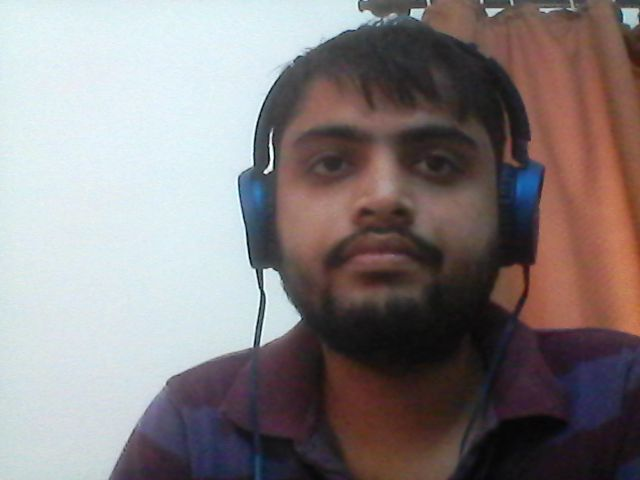

In [ ]:
from IPython.display import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

In [ ]:
from google.colab.patches import cv2_imshow

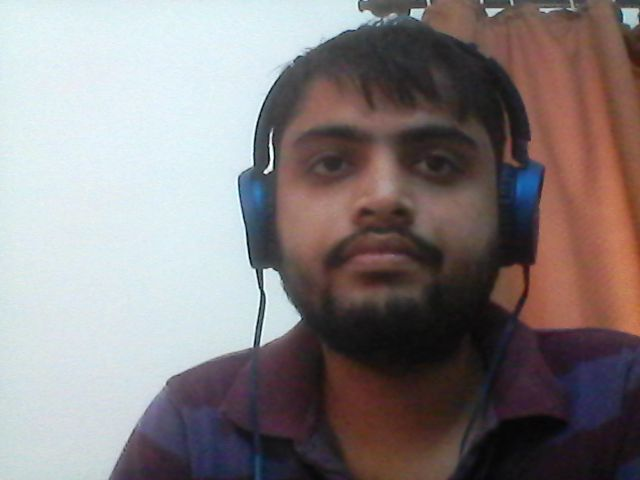

In [ ]:
img = cv2.imread('photo.jpg', cv2.IMREAD_UNCHANGED)
cv2_imshow(img)

In [ ]:
v = encoder("photo.jpg")

In [ ]:
photo_2048 = v.reshape((1,2048))

In [ ]:
caption = predict_caption(photo_2048)
print(caption)

A man wearing a blue shirt and glasses is smiling .


In [ ]:
#!unzip ./drive/MyDrive/Flickr_TextData/captions.txt.zip

In [ ]:
#!pip install kaggle

In [ ]:
#from google.colab import files
#files.upload()

#!pip install -q kaggle
#!mkdir -p ~/.kaggle
#!cp kaggle.json ~/.kaggle/
#!ls ~/.kaggle
#!chmod 600 /root/.kaggle/kaggle.json

In [ ]:
#!kaggle datasets download -d adityajn105/flickr8k

In [ ]:
#!unzip flickr8k.zip

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
from IPython.display import Audio #Import Audio method from IPython's Display Class
tts = gTTS(caption) #Provide the string to convert to speech
tts.save('2.wav') #save the string converted to speech as a .wav file
sound_file = '2.wav'
Audio(sound_file, autoplay=True) 